# Assignment 1

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from datetime import datetime
import re
import time

## Utility Functions

Functions that we use all around our assignment. 


In [2]:
# get seconds from hh:mm:ss format
def get_sec(time_str):
    """Get Seconds from time."""
    h, m, s = time_str.split(':')
    return int(h) * 3600 + int(m) * 60 + int(s)

In [3]:
# get hh:mm:ss format from seconds
def get_hhmmss(seconds: int):
  return time.strftime('%H:%M:%S', time.gmtime(seconds))


In [4]:
# get hour from hh:mm:ss
def get_hour(hour_str: str):
  return int(hour_str.split(':')[0])

# Data input and processing




In this part of the assignment we are loading the static data and the vehicle snapshots to our notebook because we will need to calculate the delays for the vehicles that or on a stop.
We need to see the structure of the data, analyze it and decide how we are going to manipulate it in order to use it for our assignment.

We are using the gtfs files from September 3rd which we will reffere to as **static** files and the vehicle positions as **vehicle positoins or dynamic data**.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google'

## Static GTFS Data


Loading the static data:

In [5]:
calendar = pd.read_csv('../data/raw/gtfs/calendar.txt')
calendar_dates = pd.read_csv('../data/raw/gtfs/calendar_dates.txt')
routes = pd.read_csv('../data/raw/gtfs/routes.txt')
stops = pd.read_csv('../data/raw/gtfs/stops.csv')
stop_times = pd.read_csv('../data/raw/gtfs/stop_times.txt')
trips = pd.read_csv('../data/raw/gtfs/trips.txt')

### Stops

We noticed that the stop_id's from stops.csv are not clean. Most of the stops were duplciated or had different records. Most of them were in a format with zeros up front and some letters at the end while still referencing to the same longtitude and latitude for that stop.

This is the part where we clean the stops and later use them as cleaned in the rest of the notebook.

In [6]:
stops.head(1)

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_type,parent_station
0,0089,NaN,MONTGOMERY,NaN,50.838006,4.40897,NaN,NaN,0,37.0


In [7]:
stops['stop_id'] = stops['stop_id'].map(lambda x: int(re.sub('[^0-9]', '', x))) # clean the letters and zeros
stops = stops.drop_duplicates() # remove the duplicates['stop_id'] = stops['stop_id'].map(lambda x: int(re.sub('[^0-9]', '', x))) # clean the letters and zeros

# if we want to save it
# stops.to_csv('/content/drive/MyDrive/hach-my-ride/gtfs3Sept/stops_cleaned.csv') 

In [8]:
stops.head(1)

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_type,parent_station
0,89,NaN,MONTGOMERY,NaN,50.838006,4.40897,NaN,NaN,0,37.0


We are doing the same thing for stop_times as we also use a stops column.

In [9]:
stop_times['stop_id'] = stop_times['stop_id'].map(lambda x: int(re.sub('[^0-9]', '', str(x)))) # clean the letters and zeros
stop_times = stop_times.drop_duplicates() # remove the duplicates

# stop_times_cleaned.to_csv('/content/drive/MyDrive/hach-my-ride/gtfs3Sept/stop_times_cleaned.csv') 


### Calendar



We can reduce the day columns and create one column holding this information. 

We also noticed that we only have the following type of patterns in the calendar.csv file:

- 1111100
- 0000010
- 0000001

Therefore we can conclude that we can use the following notation:

We use the following values:
0 - weekday, 1, saturday, 2 sunday, 3 else

In [10]:
calendar.head(1)

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date
0,234578052,1,1,1,1,1,0,0,20210823,20210831


In [11]:
# transform calendar_dates
calendar['day'] = calendar.apply(lambda x: 0 if x.monday==1 else 1 if x.saturday==1 else 2 if x.sunday==1 else 3 , axis=1)
calendar.drop(['monday','tuesday','wednesday','thursday','friday','saturday','sunday'], axis=1, inplace=True)



In [12]:
calendar.head(1)

,service_id,start_date,end_date,day
0,234578052,20210823,20210831,0


## Join the static files

In order to ease our life we decided to deal with one big table where we store all the needed data from the static gtfs files.

We called this table trips_merged as we have information for every single STIB's trip from the gtfs data. From this part on we may refere to this table as **trips**.

We can see from which date is this trip running, which calendar does it follow, at what time is it supposed to stop, what is the name of the stop, the line and other usefull information which we can be used to find the delay.

In [13]:
# make the big join, we have all the needed information
# del trips_merged
routes = routes[['route_id','route_short_name']]
stops = stops[['stop_id','stop_name']]
trips = trips[['route_id','service_id','trip_id','trip_headsign','direction_id']]
stop_times = stop_times[['trip_id','arrival_time','stop_id','stop_sequence']]
trips_merged = trips.merge(stop_times, on='trip_id', how='inner')\
                    .merge(calendar, on='service_id', how='inner')\
                    .merge(stops, on='stop_id', how='inner')\
                    .merge(routes, on='route_id', how='inner')


In [14]:
trips_merged.head(1)

,route_id,service_id,trip_id,trip_headsign,direction_id,arrival_time,stop_id,stop_sequence,start_date,end_date,day,stop_name,route_short_name
0,24,235954071,112387248235954071,SIMONIS,1,21:07:00,4014,1,20210823,20210831,0,BEEKKANT,87


## Vehicle Positions

Loading the vehicle postions:

Notice: We have previosly merged all .json vehicle files into a .csv one called .vehiclePositions.csv

In [17]:
vehicle_positions = pd.read_csv('../data/processed/assignment1/vehiclePositions.csv')

In [18]:
vehicle_positions.head(1)

,Timestamp,LineId,DirectionId,DistanceFromPoint,PointId
0,1630914886924,1,8161,1,8012


Because our vehicle_positions have a timestamp, we have to get usefull information from that value. Therefore we are adding 3 new columns from the timestamp column.

timestamp -> date, hour, day

- The date is in YYYYMMDD format. 
- The hour is extracted in HH:MM:SS.
- The day is either 0 if it is woorking day, 1 if Saturday, 2 if Sunday. We are deriving these categories from the Timestamp 

It is important to notice that we are savinga new file called *vehiclePositionsTime.csv* which we can use later in our notebook. 

In [19]:
# timestamp -> date, hour, day
# USE ONLY ONCE IF YOU NEED TO GENERATE THE COLUMNS FROM THE BASE FILE VEHICLEPOSITOISN

weekdays = ['Monday','Tuesday','Wednesday', 'Thursday','Friday']

vehicle_positions['date'] = pd.to_datetime(vehicle_positions['Timestamp'], unit='ms')
vehicle_positions['hour'] = pd.to_datetime(vehicle_positions['Timestamp'], unit='ms')
vehicle_positions['day'] = pd.to_datetime(vehicle_positions['Timestamp'], unit='ms')

vehicle_positions['date'] = vehicle_positions['date'].dt.strftime("%Y%m%d").astype(int)
vehicle_positions['hour'] = vehicle_positions['hour'].dt.strftime("%H:%M:%S")
vehicle_positions['day'] = vehicle_positions['day'].dt.strftime("%A") \
                    .apply(lambda x: 0 if x in weekdays else 1 if x=='Saturday' else 2 if x=='Sunday' else 3)

Because this operation is costly, we can't always run this code. Therefore once we run it we save it and we can use the vehiclePositionsTime.csv file.

In [ ]:
vp = vehicle_positions.copy()

In [31]:
vehicle_positions.to_csv('../data/processed/assignment2/vehiclePositionsTime.csv',mode='w', index=False)

In [ ]:
vehicle_positions.head(1)

# Caluclating the delays

In [33]:
vehicle_positions = pd.read_csv('../data/processed/assignment2/vehiclePositionsTime.csv')

Our goal now is to caluclate the delays for the vehicles from the vehicle positions file that are on a certain stop.

The way we will do this is that we will pick the vehicles that are on the stop. As we don't have the vehicle ID in the static files we will have to make an **assumption** which tripid matches the vehicle the most. 

In [41]:
# for a chosen line number get the coresponding subtable from the trips and vehicle positions
def getLineAndVehicle(line_number: int):
    line = trips_merged[trips_merged['route_short_name'] == str(line_number)]
    vehicle = vehicle_positions[vehicle_positions['LineId'] == line_number]
    return line, vehicle

In [42]:
# get the stop name from a given stop number
def getStopName(stop_number: str):
    for k,v in stops_dictionary.items():
        if(stop_number in v):
            return k

Using this function we are removing the vehicle positions that are between the first arrival time in the trips and last expected time or midnight for that exact vehicle. 

We are doing this because there are a lot of vehicles who are running outside of their schedule. Meaning that we have timestamps which are at 2 AM, but there are no scheduled busses between 11PM and 5AM.

We are also avoiding all the busses after midnight because they are represented as 00:00:00 in the vehicle positions file, while in the static files 1AM is represented as 25:00:00. We are not able to compare them as when we conver them to seconds, 01:00:00 AM will give much smaller value than 25:00:00 and will match with the earliest scheduled stop, therefore the delay will be huge and without meaning. We are also not converting the hours after 24:00:00 to 00:00:00 because...? i forgot why

In [43]:
def filterVehicles(line,vehicles):
  first_vehicle = line.arrival_time.min()
  last_vehicle = line.arrival_time.max() # could be > '24:00:00'

  # dropping by earliest vehicles (also removes the after midnight busses)
  # we give a window of 1 minute if it leaves earlier 
  vehicles.drop(vehicles.loc[(vehicles['hour'].values <= get_hhmmss(get_sec(first_vehicle) - 60))].index, inplace=True)

  # dropping busses after the last vehicle
  # It is optional because if it's past midnight it is dropped by the previous drop
  if(last_vehicle < '24:00:00'):
    vehicles.drop(vehicles.loc[(vehicles['hour'].values >= last_vehicle)].index, inplace=True)
  
  # drop the rows that are not on the bus stop
  vehicles.drop(vehicles.loc[(vehicles['DistanceFromPoint'].values != 0)].index, inplace=True)

Here we get the line corresponding to the vehicle and we filter all the possible trips that might be on that stop, between the dates in which our bus is riding and the date as well. 

This function will return the list of the possible trips to match 

In [44]:
# get the possible trips that match our vehicle snapshot
def matchTimeWithStops(line, vehicle_timestamp):
    return line.loc[(line['stop_id'].values == vehicle_timestamp.PointId) & \
                (line['start_date'].values <= vehicle_timestamp.date) & \
                (line['end_date'].values >= vehicle_timestamp.date) & \
                (line['day'].values == vehicle_timestamp.day)]


Once we get the possible trips from `matchTimeWithStops`, we are trying to find the one that is closest to our vehicle's snapshot.

The method is very naive as we are finding the closest delay to zero. We are first getting the difference between the vehicle snapshot and the delays and then we are finding the argmin in the array of delays. 

We are also using numpy vectorization as it is the fastest way to itterate through dataframes.

In [45]:
def getBestDelay(val1, val2, min_bound, max_bound):
    # [min_bound,0] priority, then [0, max_bound]
    # check if it is between min and 0
    if(min_bound <= val1 <= 0):
        if(min_bound <= val2 <= 0):
            return max(val1,val2)
        else:
            return val1
    elif(min_bound <= val2 <=0):
        return val2

    # check if it is between 0 and min
    if(0 <= val1 <= max_bound):
        if(0 <= val2 <= max_bound):
            return min(val1,val2)
        else:
            return val1
    elif(0 <= val2 <= max_bound):
        return val2

    return None

In [46]:
def calculateTheDelay(delays, vehicle_row, interval):
    def f(x, vehicle_row):
      return get_sec(x) - get_sec(vehicle_row)
      
    fvec = np.vectorize(f) 
    result_array = fvec(delays.arrival_time, vehicle_row.hour)
    result_array_abs = np.abs(result_array)
    argsort = np.argsort(result_array_abs)

    # there are cases when we only have < 2 values which are very rare. 
    try:
        arg1, arg2 = np.argsort(result_array_abs)[:2]
    except ValueError:
        return None

    min_bound = interval[0]
    max_bound = interval[1]

    val1 = result_array[arg1]
    val2 = result_array[arg2]
    best_delay = getBestDelay(val1, val2, min_bound, max_bound)
    return best_delay

In the following function we are iterating through every line and vechicle snapshots and we calculate the delay for the vehicles that are on the stop. We are using the three key functions that we mentioned before this one which are the essential logic when we are searching for the delay.

At the end we are creating a new column called 'Delay' in the vehicle position subtable for that line where we add the delay that we have counted. For the snapshots that are not on the stop we give them Null value. 


In [51]:
# If delays is empty (ex with bus 95) we get: ValueError: Columns must be same length as key
line_numbers = vehicle_positions.LineId.unique() # get all the lines that are on the network
INTERVAL = [-200, 1400]
for number in line_numbers:
    line, vehicles = getLineAndVehicle(number) # ex for line 1, we get the static files of line 1 and vp of line 1
    filterVehicles(line,vehicles)
    total_delays = []
    
    for index, vehicle_row in vehicles.iterrows(): # go through each bus that is on the stop TBD: iterrows is slow
        delays = matchTimeWithStops(line, vehicle_row) # get the delays from the matched possible stoptimes for that vehicle in that line

        if delays.empty != True: # avoid when it doesn't find anything
            final_delay = calculateTheDelay(delays, vehicle_row, INTERVAL)
            total_delays.append(final_delay)
        else:
            total_delays.append(None) # it is possible that we don't find anything from calculateTheDelay (ex. missing stops)
        
    break

    vehicles['delay'] = total_delays
    vehicles.to_csv(f'../data/processed/assignment2/vehicledelays/vehicleDelaysLine{number}.csv',mode='w', index=False)

46,-264 -> 46
64,-246 -> 64
70,-240 -> 70
120,-190 -> -190
-69,290 -> -69
59,-251 -> 59
131,-179 -> -179
-19,291 -> -19
29,-281 -> 29
-30,280 -> -30
15,-295 -> 15
39,-271 -> 39
72,-238 -> 72
-144,166 -> -144
76,-234 -> 76
-100,259 -> -100
41,-269 -> 41
100,-210 -> 100
-2,308 -> -2
-61,249 -> -61
41,-269 -> 41
135,-175 -> -175
45,-265 -> 45
-131,228 -> -131
71,-239 -> 71
10,-300 -> 10
69,-241 -> 69
-4,306 -> -4
-17,293 -> -17
30,-280 -> 30
64,-246 -> 64
59,-251 -> 59
106,-204 -> 106
-161,198 -> -161
113,-197 -> -197
19,-291 -> 19
-50,260 -> -50
31,-279 -> 31
26,-284 -> 26
67,-243 -> 67
73,-237 -> 73
165,-194 -> -194
80,-230 -> 80
63,-247 -> 63
-80,230 -> -80
72,-238 -> 72
59,-251 -> 59
136,-174 -> -174
135,-224 -> 135
36,-274 -> 36
33,-277 -> 33
10,-300 -> 10
53,-208 -> 53
39,-271 -> 39
26,-284 -> 26
103,-207 -> 103
102,-257 -> 102
3,-307 -> 3
-23,287 -> -23
-71,239 -> -71
21,-240 -> 21
70,-240 -> 70
55,-255 -> 55
65,-245 -> 65
70,-289 -> 70
69,-241 -> 69
45,-265 -> 45
75,-235 -> 75
47,

In [52]:
line, _ = getLineAndVehicle(71)

In [53]:
np.unique(line[(line['stop_id'] == 3506) & (line['service_id'] == 237625071)].arrival_time.values)

array(['05:40:32', '06:00:32', '06:14:32', '06:27:32', '06:40:32',
       '06:50:32', '07:00:32', '07:15:32', '07:27:32', '07:33:32',
       '07:39:32', '07:46:32', '07:52:32', '07:58:32', '08:10:32',
       '08:16:32', '08:22:32', '08:28:32', '08:34:32', '08:40:32',
       '08:52:32', '09:04:32', '09:10:32', '09:16:32', '09:22:32',
       '09:28:32', '09:34:32', '09:46:32', '09:52:32', '09:58:32',
       '10:04:32', '10:10:32', '10:16:32', '10:28:32', '10:41:03',
       '10:47:03', '10:53:03', '10:59:03', '11:05:03', '11:11:03',
       '11:23:03', '11:29:03', '11:35:03', '11:40:03', '11:46:03',
       '11:52:03', '12:04:03', '12:16:03', '12:22:03', '12:28:03',
       '12:34:03', '12:40:03', '12:46:03', '12:59:03', '13:05:34',
       '13:11:34', '13:17:34', '13:23:34', '13:29:34', '13:41:34',
       '13:53:34', '13:59:34', '14:05:34', '14:11:34', '14:17:34',
       '14:23:34', '14:35:34', '14:41:34', '14:47:34', '14:53:34',
       '14:59:34', '15:05:34', '15:11:34', '15:23:34', '15:35:

In [54]:

ld = line[line['direction_id'] == 0]

avg_diff1 = {}

for number in vehicle_positions.LineId.unique():

    line, _ = getLineAndVehicle(number)
    rush_hour = line[(line['arrival_time'] > '15:00:00') & (line['arrival_time'] < '16:00:00')]
    service_id = rush_hour.iloc[-1,1]
    stop_id = rush_hour.iloc[-1,6]


    line.arrival_time = line.arrival_time.apply(lambda x: get_sec(x))

    # print(f"{number}: ", ))))
    avg_diff1[number] = np.mean(np.diff(np.unique(line[(line['stop_id'] == stop_id) & (line['service_id'] == service_id)].arrival_time)))
# np.mean(np.diff(np.unique(ld[(ld['stop_id'] == 1734) & (ld['service_id'] == 237625071)].arrival_time)))



/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/pandas/core/generic.py:5516: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [55]:
avg_diff1

{1: 666.6601941747573,
 2: 553.4558823529412,
 3: 589.2307692307693,
 4: 687.8350515463917,
 5: 697.0212765957447,
 6: 414.27710843373495,
 7: 935.0649350649351,
 8: 5117.142857142857,
 9: 4710.0,
 12: 1264.6153846153845,
 13: 1261.111111111111,
 14: 1162.622950819672,
 17: 1767.0,
 19: 590.4201680672269,
 20: 1079.032258064516,
 21: 1256.4,
 25: 951.2,
 27: 1339.4117647058824,
 28: 1262.0,
 29: 892.8947368421053,
 33: 1196.3265306122448,
 34: 1026.6666666666667,
 36: 1304.1612903225807,
 37: 1256.4705882352941,
 38: 950.5714285714286,
 39: 1255.7142857142858,
 41: 1418.1818181818182,
 42: 1245.5555555555557,
 43: 1037.704918032787,
 44: 1200.0,
 45: 1059.344262295082,
 46: 454.98709677419356,
 47: 1244.4827586206898,
 48: 906.4,
 49: 523.1818181818181,
 50: 1133.7931034482758,
 51: 986.4,
 53: 863.0769230769231,
 54: 1283.5294117647059,
 55: 720.6122448979592,
 56: 1275.5555555555557,
 57: 738.5915492957746,
 58: 3044.0,
 59: 1264.4444444444443,
 60: 1008.75,
 61: 1317.9310344827586,


In [56]:
avg_diff

NameError: name 'avg_diff' is not defined

**All the subtables are saved as a new file vehicleDelaysLine{number}.csv, these files are then merged in vehicleDelays.csv**

# Cleaning the delays


In this section we will use the calculated delays and remove the null values and do some data exploration with our delays

vehicleDelays.csv is generated by a shell comand from the vehcileDelaysLine{number}.csv files



```
head -1 vehicleDelaysLine1.csv > vehicleDelays.csv   
tail -n -q +2  *.csv >> vehicleDelays.csv
```



In [57]:
# We are loading the vehicle delays here from a new file or we can use the same
delays_uncleaned = pd.read_csv('../data/processed/assignment1/vehicleDelays.csv')
# removing the None values from delay.
delays = delays_uncleaned.dropna(subset=['delay'])

In [58]:
# delays['delay'] = delays['delay'] * -1 

In [59]:
# How many vp did we lost in total?

print(f"Delays before cleaning:\t{len(delays_uncleaned.index) }")
print(f"Delays after dropping the null values:\t{len(delays.index)}")
print(f"Percentage of null values dropped:\t{(1 - (len(delays.index) / len(delays_uncleaned.index))) * 100 }")

Delays before cleaning:	6886238
Delays after dropping the null values:	5567772
Percentage of null values dropped:	19.14639023513274


Lines with the smallest number of dropped rows
LineId
92    16.172863
28    16.664691
53    17.566981
56    17.620878
33    17.645921
Name: delay, dtype: float64
Lines with the highest number of dropped rows
LineId
86     32.641112
48     38.389647
95     72.819121
70     84.400456
37    129.770329
Name: delay, dtype: float64
Average number of rows dropped by ever line 24.541557985723212 %


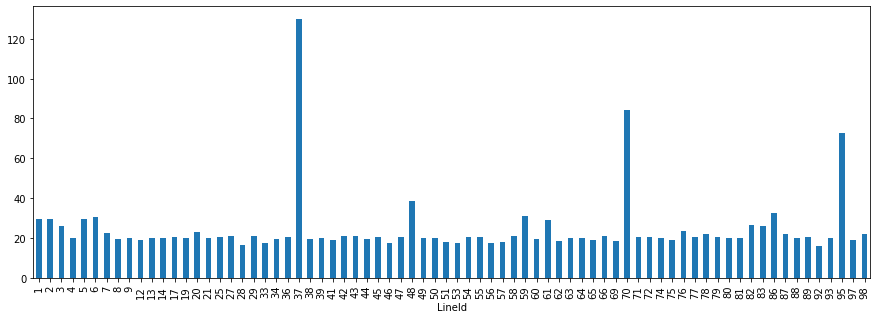

In [60]:
# TODO statistics
# How many vp did we last for every line in total
dropped_rows_by_line = delays_uncleaned.groupby(['LineId'])['delay'].agg(lambda x: x.isnull().sum() / x.count() *100)
dropped_rows_by_line.plot(kind='bar', figsize=(15,5))
dropped_rows_by_line = dropped_rows_by_line.sort_values()

print("Lines with the smallest number of dropped rows")
print(dropped_rows_by_line.head())

print("Lines with the highest number of dropped rows")
print(dropped_rows_by_line.tail())

print(f"Average number of rows dropped by ever line {dropped_rows_by_line.mean()} %")

We should now check the outliers and see how our data is being distributed


<AxesSubplot:xlabel='LineId'>

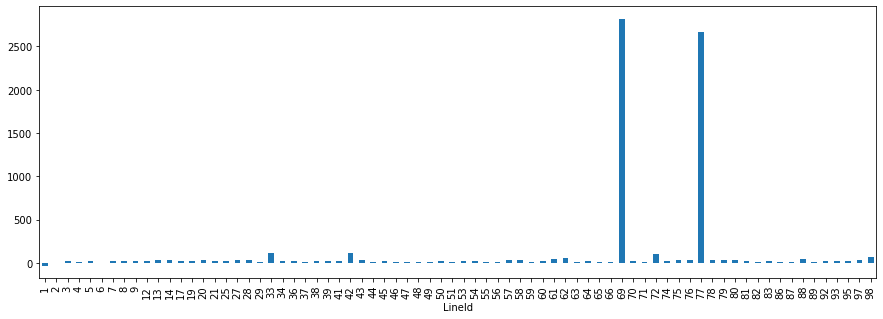

In [61]:
# CHECK THE OUTLIERS

# remove the medians 69, 77
# work on 42
#
delays.groupby('LineId')['delay'].median().plot(kind='bar', figsize=(15,5))
# from the median table we can drop line 69 and 77

We see that line number 69 and 77 have a very big median which means that most of the data has delays. We **decided to drop** these lines as they are uselss and probably there are some problems with the data for these lines

In [62]:
delays.drop(delays.loc[delays['LineId'] == 69].index, inplace=True)
delays.drop(delays.loc[delays['LineId'] == 77].index, inplace=True)

Now let's see the mean for our lines

<AxesSubplot:xlabel='LineId'>

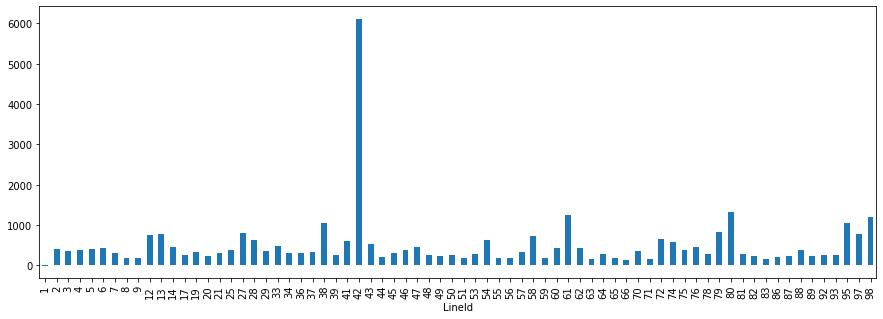

In [63]:
delays.groupby('LineId')['delay'].mean().plot(kind='bar', figsize=(15,5))

We see that line number 42 has a very big mean, so probably there are some weird issues with our delays on this line.

We will now create an interval for maximum and minimum delay. We will drop every vehicle position that is outside of this interval.
We decide to give very bus a tolerance of 5 minutes being early and 12 minutes being late

In [64]:
# TODO CHECK IF IT"S GOOD, I DIDN"T GET GOOD VALUES
def filterByIntervalDelay(delays, mindelay: int, maxdelay: int):
  delays.drop(delays.loc[(delays['delay'].values > maxdelay)].index, inplace=True)
  delays.drop(delays.loc[(delays['delay'].values < mindelay)].index, inplace=True)

<AxesSubplot:xlabel='LineId'>

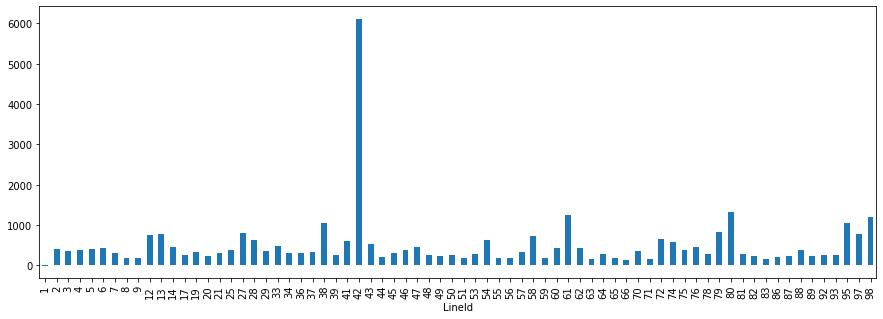

In [65]:
delays.groupby('LineId')['delay'].mean().plot(kind='bar', figsize=(15,5))

In [66]:
filterByIntervalDelay(delays, -300, 720)

<AxesSubplot:xlabel='LineId'>

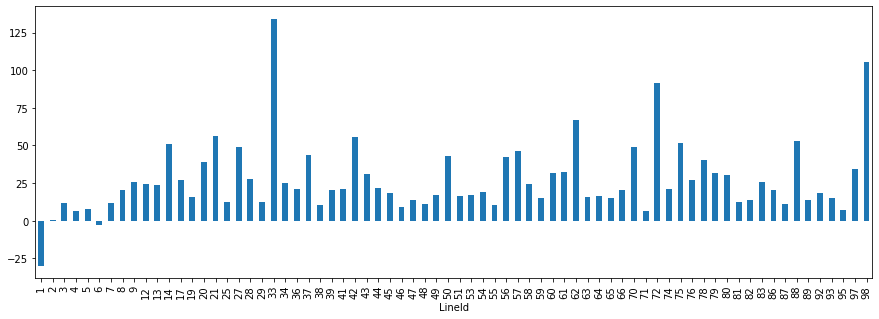

In [67]:
delays.groupby('LineId')['delay'].mean().plot(kind='bar', figsize=(15,5))

We can see from the plot of the mean that the data is more tolerable and we continue working with this data in the other sections

In [68]:
delays = delays.drop_duplicates() # we could have multiple snapshots at the same time for the same vehicle
delays.head(1)

,Timestamp,LineId,DirectionId,DistanceFromPoint,PointId,date,hour,day,delay
0,1630914886924,12,9600,0,9600,20210906,07:54:46,0,-286.0


In [69]:
delays.to_csv('../data/processed/assignment2/delaysCleaned.csv', index=False)

# Export data

We are preparing the data for the visualization part

In [70]:
delays = pd.read_csv('../data/processed/assignment2/delaysCleaned.csv')

In [71]:
delays.head()

,Timestamp,LineId,DirectionId,DistanceFromPoint,PointId,date,hour,day,delay
0,1630914886924,12,9600,0,9600,20210906,07:54:46,0,-286.0
1,1630914886924,12,1780,0,9600,20210906,07:54:46,0,-286.0
2,1630914886924,12,9600,0,1780,20210906,07:54:46,0,14.0
3,1630914886924,12,1780,0,2250,20210906,07:54:46,0,74.0
4,1630914917746,12,9600,0,1780,20210906,07:55:17,0,-17.0


In [72]:
delays = delays.drop(columns=['DistanceFromPoint'], axis=1)
delays.columns = ['Timestamp', 'LineId', 'TerminusStop', 'CurrentStop', 'Date','Hour','Day','Delay']
delays['Delay'] = delays['Delay'].astype(int)
delays['ExpectedArrivalTime'] = [ get_hhmmss(get_sec(x) - y) for x, y in zip(delays['Hour'], delays['Delay'])]
delays = delays.drop_duplicates()


In [73]:
# pd.reset_option('^display.', silent=True)
pd.set_option("display.max_rows", None)

While visualizing the data in rapidminer we noticed that the vehicles spend a lot of time on the stops. For one stop, we can have 5-6 snapshots of that vehicle staying on the stop. 
We noticed a lot of vehicle snapshots on the first stop of the trip. We **assume** that the drivers have started the device to run before even leaving the stop.

We are demonstrating this case by looking at the time a bus stays on a certain stop

In [74]:
delays_line1 = delays[delays['LineId'] == 1]

In [75]:
delays_line1.groupby(['LineId','Date','Day','TerminusStop','CurrentStop', 'ExpectedArrivalTime'])['Delay'].agg(list)

LineId  Date      Day  TerminusStop  CurrentStop  ExpectedArrivalTime
1       20210906  0    8071          8161         09:15:12                [-79]
                                                  09:15:43                [-79]
                                                  09:16:15                [-79]
                                                  09:16:48                [-79]
                                                  09:17:19                [-79]
                                                  09:17:51                [-79]
                                                  09:18:22                [-79]
                                                  09:18:53                [-79]
                                                  18:19:56                [-79]
                                                  18:20:28                [-79]
                                                  18:20:58                [-79]
                                                  

Getting the last snapshot when it leaves the first_stop for line 1

In [76]:
start_stops = np.unique(delays_line1['TerminusStop'].values)
start_delays = delays_line1.loc[(delays_line1['TerminusStop'] != delays_line1['CurrentStop']) & (delays_line1['CurrentStop'].isin(start_stops))] # the current stop is a start or terminus stop
start_delays.groupby(['LineId','Date','Day','TerminusStop','CurrentStop', 'ExpectedArrivalTime'])['Delay'].agg(list)

LineId  Date      Day  TerminusStop  CurrentStop  ExpectedArrivalTime
1       20210906  0    8071          8161         09:15:12                [-79]
                                                  09:15:43                [-79]
                                                  09:16:15                [-79]
                                                  09:16:48                [-79]
                                                  09:17:19                [-79]
                                                  09:17:51                [-79]
                                                  09:18:22                [-79]
                                                  09:18:53                [-79]
                                                  18:19:56                [-79]
                                                  18:20:28                [-79]
                                                  18:20:58                [-79]
                                                  

In [77]:
start_delays = start_delays.drop_duplicates(subset=['LineId','Date','Day','TerminusStop','CurrentStop', 'ExpectedArrivalTime'], keep='last')
start_delays.groupby(['LineId','Date','Day','TerminusStop','CurrentStop', 'ExpectedArrivalTime'])['Delay'].agg(list)

LineId  Date      Day  TerminusStop  CurrentStop  ExpectedArrivalTime
1       20210906  0    8071          8161         09:15:12                [-79]
                                                  09:15:43                [-79]
                                                  09:16:15                [-79]
                                                  09:16:48                [-79]
                                                  09:17:19                [-79]
                                                  09:17:51                [-79]
                                                  09:18:22                [-79]
                                                  09:18:53                [-79]
                                                  18:19:56                [-79]
                                                  18:20:28                [-79]
                                                  18:20:58                [-79]
                                                  


In order to avoid these problems we are dropping some rows:
- We only take the last snapshot when our vehicle is on the first stop.
- We take the first stop when the vehicle reaches an intermediate stop and on the last/terminus stop.

In the following code we are treating all the cases

In [81]:
line_numbers = delays.LineId.unique()
drop_condition = ['LineId','Date','Day','TerminusStop','CurrentStop','ExpectedArrivalTime']

all_delays = []

for line in line_numbers:
  # dropping the start stops
  start_stops = np.unique(delays[delays['LineId'] == line]['TerminusStop'].values)

  start_delays = delays.loc[(delays["LineId"] == line) & (delays['TerminusStop'] != delays['CurrentStop']) & (delays['CurrentStop'].isin(start_stops))] # the current stop is a start or terminus stop
  start_delays = start_delays.drop_duplicates(subset=drop_condition, keep='last')

  # dropping the intermediate stops
  intermediate_delays = delays.loc[(delays['LineId'] == line) & \
                              ~(delays['CurrentStop'].isin(start_stops))]

  intermediate_delays = intermediate_delays.drop_duplicates(subset=drop_condition, keep='first')

  # dropping the terminus stops
  terminus_delays = delays.loc[(delays['LineId'] == line) & \
                               (delays['TerminusStop'] == delays['CurrentStop'])]

  terminus_delays = terminus_delays.drop_duplicates(subset=drop_condition, keep='first')

  # merging them all in one
  df_concat = pd.concat([start_delays.reset_index(drop=True),\
                         intermediate_delays.reset_index(drop=True),\
                         terminus_delays.reset_index(drop=True)])
  
  all_delays.append(df_concat.reset_index(drop=True))

# for each line we merge the delays
final_filtered_delays = pd.concat(all_delays)

In [ ]:
final_filtered_delays

In [79]:
final_filtered_delays.to_csv('../data/processed/assignment2/final_filtered_delays.csv', index=False)

NameError: name 'final_filtered_delays' is not defined

These are the final delays of this assignment. We will also use them in the visualization part.

In [80]:
final_filtered_delays.head()

NameError: name 'final_filtered_delays' is not defined

# Statistics. TBDone

In [ ]:
final_delays = pd.read_csv('../data/processed/assignment2/final_filtered_delays.csv')

In [ ]:
final_delays = final_delays.merge(stops[['stop_name', 'stop_id']], left_on='CurrentStop', right_on='stop_id')
final_delays = final_delays.drop(columns=['stop_id'])

In [ ]:
# creating the hour_interval column to know in which hour is the delay
final_delays['hour_interval'] = final_delays['Hour'].apply(lambda x: str(x.split(':')[0] + ':00'))

In [ ]:
final_delays.head()

In [ ]:
# What point of the day do we have the biggest delays

final_delays.groupby('hour_interval')['Delay'].mean().plot()

In [ ]:
# stops that have the biggest delay
delay_by_stop = final_delays.groupby('stop_name')['Delay'].mean()
delay_by_stop = delay_by_stop.sort_values()
delay_by_stop.tail()

In [ ]:
# stop that are very early
delay_by_stop.head()

In [ ]:
# stops that are the closest to be on time
delay_by_stop[delay_by_stop.abs().sort_values().head(10).index]

In [ ]:
# line that has the biggest delay
delay_by_line = final_delays.groupby('LineId')['Delay'].mean()
delay_by_line = delay_by_line.sort_values()
delay_by_line.tail()

In [ ]:
# line that is early
delay_by_line.head()

In [ ]:
# line that is most on time
delay_by_line[delay_by_line.abs().sort_values().head(5).index]

In [ ]:
# for each line get distribution how late they are. see if they are more on the left right
# get which ones are me late/less late


# stops[stops.stop_id.isin(delays_stops.get(1))]

# delays.groupby(['LineId', 'PointId'])['delay'].mean()
# stops
final_delays.groupby(['LineId', 'stop_name'], sort=False)['Delay'].mean().get(1)
# df.iloc[df.prod(1).argsort()]
# delays.iloc[
# delays_stops.
# df.loc[df['column_name'].isin(some_values)]
# delays_stops.get(1)
# delays_with_stop_names

delays_stops = final_delays.groupby('LineId')['CurrentStop'].unique()
# delays_stops.get(1)
delays_stops[1]

In [ ]:
final_delays[final_delays['LineId'] == 12].groupby(['CurrentStop'])['Delay'].mean()

In [ ]:
# Get which line is slow at what point of the day
delays_with_stop_names.groupby(['LineId', 'interval'])['delay'].median()

In [ ]:
# Get the delays for each stop at different point of day
delays_with_stop_names.groupby(['stop_name', 'interval'])['delay'].mean()

In [ ]:
# Get the delays for each stop for a single line at different point of day

In [ ]:
# Foreach interval get the stop that is the busiest
delays_with_stop_names.groupby(['interval','stop_name'])['delay'].mean()

In [ ]:
delays_with_stop_names.groupby(['stop_name', 'interval'])['delay'].mean()

In [ ]:
# Map how it gradually goes up and down for each hour

In [ ]:
delays

In [ ]:
delays_with_stop_names['delay'] = delays_with_stop_names['delay'].astype(int)

In [ ]:
dd = delays_with_stop_names[(delays_with_stop_names['delay'] <= 900) & (delays_with_stop_names['delay'] > -900)]

In [ ]:
a = dd.groupby(['interval','LineId'])['delay'].mean()

# Interesting things

In [ ]:
# if we inner join the stations we will loose like 213049 timestamps because 7104 is missing
# TODO: check how right join will work, or maybe get terminus and add the stops
vehicle['DirectionId'].value_counts()

In [ ]:
# the progression of busses being close to a station 
[len(vehicle[vehicle['DistanceFromPoint'].apply(lambda x: x<=i)]) for i in range(20)]



**Possible problems:**
- Some lanes have different route_short_name. I think there is a line 1 and a M1, but they are the same line. Also, there are tram lines that have T## and others that don't have the T, like 93, 92
- Departure and arrival times are the same. We can ommit one column
    stop_times['arrival_time'].equals(stop_times['departure_time'])
- The timestamp format is including miliseconds which give error (54061 year). we can remove the last 3 digitis which are the miliseconds